### Student Information
Name: Duygu

Student ID: X1100011

GitHub ID: duygu-bayrak

Kaggle name: duygub 

Kaggle private scoreboard snapshot:


![](rank.png)

[Snapshot](rank.png)

---

### Instructions

1. First: __This part is worth 30% of your grade.__ Do the **take home** exercises in the [DM2021-Lab2-master Repo](https://github.com/fhcalderon87/DM2021-Lab2-master). You may need to copy some cells from the Lab notebook to this notebook. 


2. Second: __This part is worth 30% of your grade.__ Participate in the in-class [Kaggle Competition](https://www.kaggle.com/c/dm2021-lab2-hw2/) regarding Emotion Recognition on Twitter. The scoring will be given according to your place in the Private Leaderboard ranking: 
    - **Bottom 40%**: Get 20% of the 30% available for this section.

    - **Top 41% - 100%**: Get (60-x)/6 + 20 points, where x is your ranking in the leaderboard (ie. If you rank 3rd your score will be (60-3)/6 + 20 = 29.5% out of 30%)   
    Submit your last submission __BEFORE the deadline (Dec. 24th 11:59 pm, Friday)__. Make sure to take a screenshot of your position at the end of the competition and store it as '''pic0.png''' under the **img** folder of this repository and rerun the cell **Student Information**.
    

3. Third: __This part is worth 30% of your grade.__ A report of your work developping the model for the competition (You can use code and comment it). This report should include what your preprocessing steps, the feature engineering steps and an explanation of your model. You can also mention different things you tried and insights you gained. 


4. Fourth: __This part is worth 10% of your grade.__ It's hard for us to follow if your code is messy :'(, so please **tidy up your notebook** and **add minimal comments where needed**.


Upload your files to your repository then submit the link to it on the corresponding e-learn assignment.

Make sure to commit and save your changes to your repository __BEFORE the deadline (Dec. 29th 11:59 pm, Wednesday)__. 

# 1. Part

In [2]:
import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

/kaggle/input/dm2021-lab2-hw2/tweets_DM.json
/kaggle/input/dm2021-lab2-hw2/sampleSubmission.csv
/kaggle/input/dm2021-lab2-hw2/data_identification.csv
/kaggle/input/dm2021-lab2-hw2/emotion.csv
/kaggle/input/dmlab2/confusion.PNG
/kaggle/input/dmlab2-ww/GoogleNews-vectors-negative300.bin
/kaggle/input/dmlab2-ww/DM2021-Lab2-master/pics/pic2.png
/kaggle/input/dmlab2-ww/DM2021-Lab2-master/pics/pic0.png
/kaggle/input/dmlab2-ww/DM2021-Lab2-master/pics/pic6.png
/kaggle/input/dmlab2-ww/DM2021-Lab2-master/pics/pic1.png
/kaggle/input/dmlab2-ww/DM2021-Lab2-master/pics/pic3.png
/kaggle/input/dmlab2-ww/DM2021-Lab2-master/pics/pic5.png
/kaggle/input/dmlab2-ww/DM2021-Lab2-master/pics/pic8.png
/kaggle/input/dmlab2-ww/DM2021-Lab2-master/pics/pic4.png
/kaggle/input/dmlab2-ww/DM2021-Lab2-master/pics/pic7.png
/kaggle/input/dmlab2-ww/DM2021-Lab2-master/logs/training_log.csv
/kaggle/input/dmlab2-ww/DM2021-Lab2-master/data/README.md
/kaggle/input/dmlab2-ww/DM2021-Lab2-master/data/test_df.pkl
/kaggle/input/dmla

## Code for Exercise 1

In [3]:
import pandas as pd
path = "/kaggle/input/dmlab2-ww/DM2021-Lab2-master/"
### training data
anger_train = pd.read_csv(path+"data/semeval/train/anger-ratings-0to1.train.txt",
                         sep="\t", header=None,names=["id", "text", "emotion", "intensity"])
sadness_train = pd.read_csv(path+"data/semeval/train/sadness-ratings-0to1.train.txt",
                         sep="\t", header=None, names=["id", "text", "emotion", "intensity"])
fear_train = pd.read_csv(path+"data/semeval/train/fear-ratings-0to1.train.txt",
                         sep="\t", header=None, names=["id", "text", "emotion", "intensity"])
joy_train = pd.read_csv(path+"data/semeval/train/joy-ratings-0to1.train.txt",
                         sep="\t", header=None, names=["id", "text", "emotion", "intensity"])

In [39]:
# combine 4 sub-dataset
train_df = pd.concat([anger_train, fear_train, joy_train, sadness_train], ignore_index=True)

In [40]:
### testing data
anger_test = pd.read_csv(path+"data/semeval/dev/anger-ratings-0to1.dev.gold.txt",
                         sep="\t", header=None, names=["id", "text", "emotion", "intensity"])
sadness_test = pd.read_csv(path+"data/semeval/dev/sadness-ratings-0to1.dev.gold.txt",
                         sep="\t", header=None, names=["id", "text", "emotion", "intensity"])
fear_test = pd.read_csv(path+"data/semeval/dev/fear-ratings-0to1.dev.gold.txt",
                         sep="\t", header=None, names=["id", "text", "emotion", "intensity"])
joy_test = pd.read_csv(path+"data/semeval/dev/joy-ratings-0to1.dev.gold.txt",
                         sep="\t", header=None, names=["id", "text", "emotion", "intensity"])

# combine 4 sub-dataset
test_df = pd.concat([anger_test, fear_test, joy_test, sadness_test], ignore_index=True)
train_df.head()

,id,text,emotion,intensity
0,10000,How the fu*k! Who the heck! moved my fridge!.....,anger,0.938
1,10001,So my Indian Uber driver just called someone t...,anger,0.896
2,10002,@DPD_UK I asked for my parcel to be delivered ...,anger,0.896
3,10003,so ef whichever butt wipe pulled the fire alar...,anger,0.896
4,10004,Don't join @BTCare they put the phone down on ...,anger,0.896


In [41]:
# shuffle dataset
train_df = train_df.sample(frac=1)
test_df = test_df.sample(frac=1)

---
### ** >>> Exercise 1 (Take home): **  
Plot word frequency for Top 30 words in both train and test dataset. (Hint: refer to DM lab 1)


In [42]:
# Answer here
import re
from collections import Counter

def split_sentence(sentence):
    return list(filter(lambda x: len(x) > 0, re.split('\W+', sentence.lower())))

def generate_vocabulary(train_captions, min_threshold):
    """
    Return {token: index} for all train tokens (words) that occur min_threshold times or more, 
        `index` should be from 0 to N, where N is a number of unique tokens in the resulting dictionary.
    """  
    #convert the list of whole captions to one string
    concat_str = ' '.join([str(elem).strip('\n') for elem in train_captions]) 
    #divide the string tokens (individual words), by calling the split_sentence function 
    individual_words = split_sentence(concat_str)
    #create a list of words that happen min_threshold times or more in that string  
    #condition_keys = sorted([key for key, value in Counter(individual_words).items() if value >= min_threshold])
    #generate the vocabulary(dictionary)
    #result = dict(zip(condition_keys, range(len(condition_keys))))
    return Counter(individual_words)#result

In [43]:
# word frequency for Top 30 words in train dataset
train_freqs = generate_vocabulary(train_df.text.tolist(), 0)
train_freqs.most_common(30)

[('the', 1736),
 ('i', 1643),
 ('to', 1289),
 ('a', 1205),
 ('and', 955),
 ('you', 796),
 ('of', 793),
 ('is', 787),
 ('it', 717),
 ('in', 626),
 ('s', 566),
 ('that', 537),
 ('my', 535),
 ('t', 508),
 ('for', 446),
 ('on', 390),
 ('be', 383),
 ('me', 380),
 ('this', 350),
 ('so', 328),
 ('have', 312),
 ('not', 303),
 ('just', 301),
 ('but', 293),
 ('n', 290),
 ('with', 288),
 ('m', 277),
 ('at', 269),
 ('can', 257),
 ('all', 243)]

In [44]:
# word frequency for Top 30 words in train dataset
test_freqs = generate_vocabulary(test_df.text.tolist(), 0)
test_freqs.most_common(30)

[('i', 164),
 ('the', 153),
 ('to', 138),
 ('a', 114),
 ('and', 92),
 ('of', 83),
 ('it', 83),
 ('you', 82),
 ('is', 77),
 ('in', 69),
 ('s', 61),
 ('for', 57),
 ('that', 55),
 ('t', 53),
 ('my', 52),
 ('on', 46),
 ('be', 40),
 ('me', 36),
 ('so', 34),
 ('was', 34),
 ('can', 32),
 ('at', 30),
 ('all', 30),
 ('have', 30),
 ('with', 29),
 ('just', 29),
 ('are', 29),
 ('get', 26),
 ('but', 26),
 ('your', 24)]

---
### ** >>> Exercise 2 (Take home): **  
Generate an embedding using the TF-IDF vectorizer instead of th BOW one with 1000 features and show the feature names for features [100:110].

In [45]:
import nltk
nltk.download('punkt')

[nltk_data] Error loading punkt: <urlopen error [Errno -3] Temporary
[nltk_data]     failure in name resolution>


False

In [46]:
# Answer here
from sklearn.feature_extraction.text import TfidfVectorizer

tfidf_vectorizer = TfidfVectorizer(max_features=1000, tokenizer=nltk.word_tokenize)

train_data_tfidf_features_1000 = tfidf_vectorizer.fit_transform(train_df['text'])
test_data_tfidf_features = tfidf_vectorizer.transform(test_df['text'])

train_data_tfidf_features_1000.shape

(3613, 1000)

In [47]:
feature_names_tfidf = tfidf_vectorizer.get_feature_names()
feature_names_tfidf[100:110]

['awesome', 'awful', 'b', 'baby', 'back', 'bad', 'ball', 'balls', 'bb18', 'bc']

In [48]:
"😂" in feature_names_tfidf

True

## code needed for Exercise 3

In [49]:
from sklearn.feature_extraction.text import CountVectorizer

# build analyzers (bag-of-words)
BOW_500 = CountVectorizer(max_features=500, tokenizer=nltk.word_tokenize) 

# apply analyzer to training data
BOW_500.fit(train_df['text'])

train_data_BOW_features_500 = BOW_500.transform(train_df['text'])

## check dimension
train_data_BOW_features_500.shape

/opt/conda/lib/python3.7/site-packages/sklearn/feature_extraction/text.py:484: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn("The parameter 'token_pattern' will not be used"


(3613, 500)

In [50]:
from sklearn.tree import DecisionTreeClassifier

# for a classificaiton problem, you need to provide both training & testing data
X_train = BOW_500.transform(train_df['text'])
y_train = train_df['emotion']

X_test = BOW_500.transform(test_df['text'])
y_test = test_df['emotion']

## take a look at data dimension is a good habbit  :)
print('X_train.shape: ', X_train.shape)
print('y_train.shape: ', y_train.shape)
print('X_test.shape: ', X_test.shape)
print('y_test.shape: ', y_test.shape)

X_train.shape:  (3613, 500)
y_train.shape:  (3613,)
X_test.shape:  (347, 500)
y_test.shape:  (347,)


In [51]:
## build DecisionTree model
DT_model = DecisionTreeClassifier(random_state=0)

## training!
DT_model = DT_model.fit(X_train, y_train)

## predict!
y_train_pred = DT_model.predict(X_train)
y_test_pred = DT_model.predict(X_test)

## so we get the pred result
y_test_pred[:10]

array(['joy', 'fear', 'sadness', 'fear', 'sadness', 'joy', 'sadness',
       'fear', 'fear', 'joy'], dtype=object)

In [52]:
## check by confusion matrix
from sklearn.metrics import confusion_matrix

cm = confusion_matrix(y_true=y_test, y_pred=y_test_pred) 
print(cm)

[[57 11  7  9]
 [11 75 14 10]
 [ 6 13 53  7]
 [ 7 12 11 44]]


In [53]:
# Funciton for visualizing confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import itertools

def plot_confusion_matrix(cm, classes, title='Confusion matrix',
                          cmap=sns.cubehelix_palette(as_cmap=True)):
    """
    This function is modified from: 
    http://scikit-learn.org/stable/auto_examples/model_selection/plot_confusion_matrix.html
    """
    classes.sort()
    tick_marks = np.arange(len(classes))    
    
    fig, ax = plt.subplots(figsize=(5,5))
    im = ax.imshow(cm, interpolation='nearest', cmap=cmap)
    ax.figure.colorbar(im, ax=ax)
    ax.set(xticks=np.arange(cm.shape[1]),
           yticks=np.arange(cm.shape[0]),
           xticklabels = classes,
           yticklabels = classes,
           title = title,
           xlabel = 'True label',
           ylabel = 'Predicted label')

    fmt = 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt), horizontalalignment="center", color="white" if cm[i, j] > thresh else "black")
    ylim_top = len(classes) - 0.5
    plt.ylim([ylim_top, -.5])
    plt.tight_layout()
    plt.show()

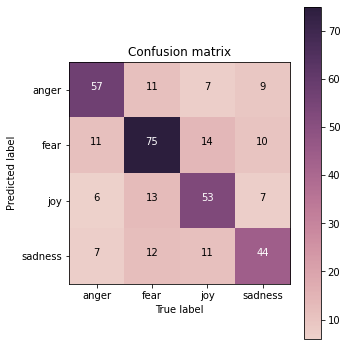

In [54]:
# plot your confusion matrix
my_tags = ['anger', 'fear', 'joy', 'sadness']
plot_confusion_matrix(cm, classes=my_tags, title='Confusion matrix')

---
### ** >>> Exercise 3 (Take home): **  
Can you interpret the results above? What do they mean?


# Answer here
the model classified:
- 57 sentences correctly as anger
- 75 sentences correctly as fear
- 53 sentences correctly as joy
- 44 sentences correctly as sadness

the model misclassified:
- 11 fear, 7 joy, and 9 sadness sentences as anger
- 11 anger, 14 joy, and 10 sadness sentences as fear
- 6 anger, 13, fear, and 7 sadness sentences as joy
- 7 anger, 12 fear, and 11 joy sentences as sadness

---
### ** >>> Exercise 4 (Take home): **  
Build a model using a ```Naive Bayes``` model and train it. What are the testing results? 

*Reference*: https://scikit-learn.org/stable/modules/generated/sklearn.naive_bayes.MultinomialNB.html


In [55]:
# Answer here
from sklearn.naive_bayes import MultinomialNB
clf = MultinomialNB(alpha=0.1)

#train
clf.fit(X_train, y_train)

## predict!
y_train_pred = clf.predict(X_train)
y_test_pred = clf.predict(X_test)

## so we get the pred result
y_test_pred[:10]

array(['joy', 'fear', 'sadness', 'fear', 'sadness', 'joy', 'sadness',
       'sadness', 'fear', 'fear'], dtype='<U7')

In [56]:
## accuracy
from sklearn.metrics import accuracy_score

acc_train = accuracy_score(y_true=y_train, y_pred=y_train_pred)
acc_test = accuracy_score(y_true=y_test, y_pred=y_test_pred)

print('training accuracy: {}'.format(round(acc_train, 2)))
print('testing accuracy: {}'.format(round(acc_test, 2)))

training accuracy: 0.8
testing accuracy: 0.73


---
### ** >>> Exercise 5 (Take home): **  

How do the results from the Naive Bayes model and the Decision Tree model compare? How do you interpret these differences? Use the theoretical background covered in class to try and explain these differences.

# Answer here
The decision tree model yielded a training accuracy of 0.99 and a testing accuracy of 0.66.
The naive bayes model yielded a training accuracy of 0.8 and a testing accuracy of 0.73.

Since the first model has a training accuracy of 99%, I would say that it is overfitting to the train data. This would also explain the lower testing accuracy compared to the second model.
The second model generalizes better, the testing accuracy is not much lower than the training accuracy. This is because the Naive Bayes classifier employs a very simple (linear) hypothesis function, which prevents it from overfitting to its training data.



## Code for Exercise 6

In [57]:
# pip3 install keras
import keras

In [58]:
## deal with label (string -> one-hot)

from sklearn.preprocessing import LabelEncoder

label_encoder = LabelEncoder()
label_encoder.fit(y_train)
print('check label: ', label_encoder.classes_)
print('\n## Before convert')
print('y_train[0:4]:\n', y_train[0:4])
print('\ny_train.shape: ', y_train.shape)
print('y_test.shape: ', y_test.shape)

def label_encode(le, labels):
    enc = le.transform(labels)
    return keras.utils.np_utils.to_categorical(enc) #keras.utils.to_categorical(enc)

def label_decode(le, one_hot_label):
    dec = np.argmax(one_hot_label, axis=1)
    return le.inverse_transform(dec)

y_train = label_encode(label_encoder, y_train)
y_test = label_encode(label_encoder, y_test)

print('\n\n## After convert')
print('y_train[0:4]:\n', y_train[0:4])
print('\ny_train.shape: ', y_train.shape)
print('y_test.shape: ', y_test.shape)


check label:  ['anger' 'fear' 'joy' 'sadness']

## Before convert
y_train[0:4]:
 3051    sadness
2665        joy
3108    sadness
2939    sadness
Name: emotion, dtype: object

y_train.shape:  (3613,)
y_test.shape:  (347,)


## After convert
y_train[0:4]:
 [[0. 0. 0. 1.]
 [0. 0. 1. 0.]
 [0. 0. 0. 1.]
 [0. 0. 0. 1.]]

y_train.shape:  (3613, 4)
y_test.shape:  (347, 4)


In [59]:
# I/O check
input_shape = X_train.shape[1]
print('input_shape: ', input_shape)

output_shape = len(label_encoder.classes_)
print('output_shape: ', output_shape)

input_shape:  500
output_shape:  4


In [60]:
from keras.models import Model
from keras.layers import Input, Dense
from keras.layers import ReLU, Softmax

# input layer
model_input = Input(shape=(input_shape, ))  # 500
X = model_input

# 1st hidden layer
X_W1 = Dense(units=64)(X)  # 64
H1 = ReLU()(X_W1)

# 2nd hidden layer
H1_W2 = Dense(units=64)(H1)  # 64
H2 = ReLU()(H1_W2)

# output layer
H2_W3 = Dense(units=output_shape)(H2)  # 4
H3 = Softmax()(H2_W3)

model_output = H3

# create model
model = Model(inputs=[model_input], outputs=[model_output])

# loss function & optimizer
model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['accuracy'])

# show model construction
model.summary()

Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 500)]             0         
_________________________________________________________________
dense_3 (Dense)              (None, 64)                32064     
_________________________________________________________________
re_lu_2 (ReLU)               (None, 64)                0         
_________________________________________________________________
dense_4 (Dense)              (None, 64)                4160      
_________________________________________________________________
re_lu_3 (ReLU)               (None, 64)                0         
_________________________________________________________________
dense_5 (Dense)              (None, 4)                 260       
_________________________________________________________________
softmax_1 (Softmax)          (None, 4)                 0   

In [61]:
# You can write up to 20GB to the current directory (/kaggle/working/)
path = "/kaggle/working/"

import pandas as pd
df = pd.DataFrame(list())
df.to_csv(path+'training_log.csv')

In [62]:
from keras.callbacks import CSVLogger


csv_logger = CSVLogger(path+'training_log.csv')

# training setting
epochs = 25
batch_size = 32

# training!
history = model.fit(X_train, y_train, 
                    epochs=epochs, 
                    batch_size=batch_size, 
                    callbacks=[csv_logger],
                    validation_data = (X_test, y_test))
print('training finish')

Epoch 1/25


/opt/conda/lib/python3.7/site-packages/tensorflow/python/framework/indexed_slices.py:449: UserWarning: Converting sparse IndexedSlices(IndexedSlices(indices=Tensor("gradient_tape/model_1/dense_3/embedding_lookup_sparse/Reshape_1:0", shape=(None,), dtype=int32), values=Tensor("gradient_tape/model_1/dense_3/embedding_lookup_sparse/Reshape:0", shape=(None, 64), dtype=float32), dense_shape=Tensor("gradient_tape/model_1/dense_3/embedding_lookup_sparse/Cast:0", shape=(2,), dtype=int32))) to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "shape. This may consume a large amount of memory." % value)
2021-12-23 10:35:58.315800: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:185] None of the MLIR Optimization Passes are enabled (registered 2)


113/113 [==============================] - 2s 5ms/step - loss: 1.3249 - accuracy: 0.3653 - val_loss: 1.2897 - val_accuracy: 0.4265
Epoch 2/25
113/113 [==============================] - 0s 2ms/step - loss: 0.9806 - accuracy: 0.6471 - val_loss: 0.9518 - val_accuracy: 0.6455
Epoch 3/25
113/113 [==============================] - 0s 2ms/step - loss: 0.5639 - accuracy: 0.8004 - val_loss: 0.8095 - val_accuracy: 0.6974
Epoch 4/25
113/113 [==============================] - 0s 2ms/step - loss: 0.3906 - accuracy: 0.8572 - val_loss: 0.7850 - val_accuracy: 0.7089
Epoch 5/25
113/113 [==============================] - 0s 2ms/step - loss: 0.3047 - accuracy: 0.8926 - val_loss: 0.8249 - val_accuracy: 0.7089
Epoch 6/25
113/113 [==============================] - 0s 3ms/step - loss: 0.2511 - accuracy: 0.9114 - val_loss: 0.8608 - val_accuracy: 0.6916
Epoch 7/25
113/113 [==============================] - 0s 2ms/step - loss: 0.2031 - accuracy: 0.9338 - val_loss: 0.9358 - val_accuracy: 0.6801
Epoch 8/25
113/11

In [63]:
#Let's take a look at the training log
training_log = pd.DataFrame()
training_log = pd.read_csv(path+"training_log.csv")
training_log.head()

,epoch,accuracy,loss,val_accuracy,val_loss
0,0,0.365347,1.324902,0.426513,1.289690
1,1,0.647108,0.980573,0.645533,0.951760
2,2,0.800443,0.563931,0.697406,0.809467
3,3,0.857182,0.390636,0.708934,0.785027
4,4,0.892610,0.304680,0.708934,0.824886


---
### ** >>> Exercise 6 (Take home): **  

Plot the Training and Validation Accuracy and Loss (different plots), just like the images below (Note: the pictures below are an example from a different model). How to interpret the graphs you got? How are they related to the concept of overfitting/underfitting covered in class?
<table><tr>
    <td><img src="pics/pic3.png" style="width: 300px;"/> </td>
    <td><img src="pics/pic4.png" style="width: 300px;"/> </td>
</tr></table>

In [64]:
# Answer here
train_acc = training_log['accuracy'].tolist()
val_acc = training_log['val_accuracy'].tolist()
train_loss = training_log['loss'].tolist()
val_loss = training_log['val_loss'].tolist()

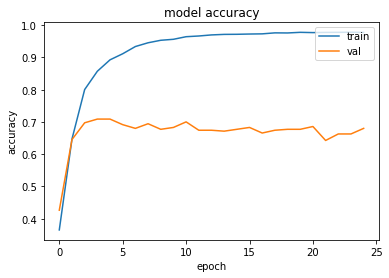

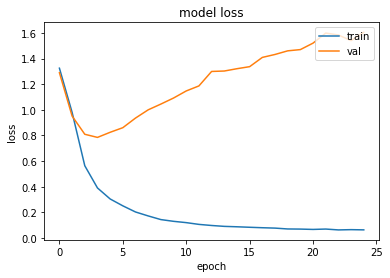

In [65]:
from matplotlib import pyplot as plt

plt.plot(train_acc)
plt.plot(val_acc)
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper right')
plt.show()

plt.plot(train_loss)
plt.plot(val_loss)
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper right')
plt.show()

we can clearly see an overfitiing here. If we look at the graph "model loss", we can see that the validation loss first decreases until epoch 4 and then it increases. The train loss, however, keeps decreasing and reaches almost 0% at epoch 25. If we then look at the graph "model accuracy", we can see that the train accuracy increases very steeply and flattens after epoch 5. So, at about epoch 4 the train accuracy reaches 90% and this is the point where the overfitting happens since the validation loss then starts to increase again.

---
### ** >>> Exercise 7 (Take home): **  

Now, we have the word vectors, but our input data is a sequence of words (or say sentence). 
How can we utilize these "word" vectors to represent the sentence data and train our model?


## Answer: we can calculate the average vector for all words in every sentence (see code below)

In [66]:
# Answer here
# calculate the average vector for all words in every sentence
def get_mean_vector(word2vec_model, words):
    # remove out-of-vocabulary words
    words = [word for word in words if word in word2vec_model.vocab]
    if len(words) >= 1:
        return np.mean(word2vec_model[words], axis=0)
    else:
        return []

---
### ** >>> Exercise 8 (Take home): **  

Generate a t-SNE visualization to show the 15 words most related to the words "angry", "happy", "sad", "fear" (60 words total).

In [67]:
from gensim.models import KeyedVectors

## Note: this model is very huge, this will take some time ...
model_path = "/kaggle/input/dmlab2-ww/GoogleNews-vectors-negative300.bin" #"GoogleNews/GoogleNews-vectors-negative300.bin.gz"
w2v_google_model = KeyedVectors.load_word2vec_format(model_path, binary=True)
print('load ok')

w2v_google_model.most_similar('happy', topn=10)

load ok


[('glad', 0.7408890724182129),
 ('pleased', 0.6632170677185059),
 ('ecstatic', 0.6626912355422974),
 ('overjoyed', 0.6599286794662476),
 ('thrilled', 0.6514049172401428),
 ('satisfied', 0.6437949538230896),
 ('proud', 0.636042058467865),
 ('delighted', 0.627237856388092),
 ('disappointed', 0.6269949674606323),
 ('excited', 0.6247665286064148)]

In [68]:
# Answer here
word_list = ['happy', 'angry', 'sad', 'fear']

topn = 15
happy_words = [word_ for word_, sim_ in w2v_google_model.most_similar('happy', topn=topn)]
angry_words = [word_ for word_, sim_ in w2v_google_model.most_similar('angry', topn=topn)]        
sad_words = [word_ for word_, sim_ in w2v_google_model.most_similar('sad', topn=topn)]        
fear_words = [word_ for word_, sim_ in w2v_google_model.most_similar('fear', topn=topn)]        

print('happy_words: ', happy_words)
print('angry_words: ', angry_words)
print('sad_words: ', sad_words)
print('fear_words: ', fear_words)

target_words = happy_words + angry_words + sad_words + fear_words
print('\ntarget words: ')
print(target_words)

print('\ncolor list:')
cn = topn 
color = ['b'] * cn + ['g'] * cn + ['r'] * cn + ['y'] * cn
print(color)

happy_words:  ['glad', 'pleased', 'ecstatic', 'overjoyed', 'thrilled', 'satisfied', 'proud', 'delighted', 'disappointed', 'excited', 'happier', 'Said_Hirschbeck', 'elated', 'thankful', 'unhappy']
angry_words:  ['irate', 'enraged', 'indignant', 'incensed', 'annoyed', 'agitated', 'frustrated', 'furious', 'unhappy', 'outraged', 'livid', 'irritated', 'exasperated', 'angrier', 'Angry']
sad_words:  ['saddening', 'Sad', 'saddened', 'heartbreaking', 'disheartening', 'Meny_Friedman', 'parishioner_Pat_Patello', 'saddens_me', 'distressing', 'reminders_bobbing', 'Turkoman_Shiites', 'saddest', 'unfortunate', 'sorry', 'bittersweet']
fear_words:  ['fearful', 'fears', 'Fear', 'fearing', 'worry', 'dread', 'feared', 'anxiety', 'apprehension', 'afraid', 'worries', 'concern', 'distrust', 'worried', 'Fearful']

target words: 
['glad', 'pleased', 'ecstatic', 'overjoyed', 'thrilled', 'satisfied', 'proud', 'delighted', 'disappointed', 'excited', 'happier', 'Said_Hirschbeck', 'elated', 'thankful', 'unhappy', '

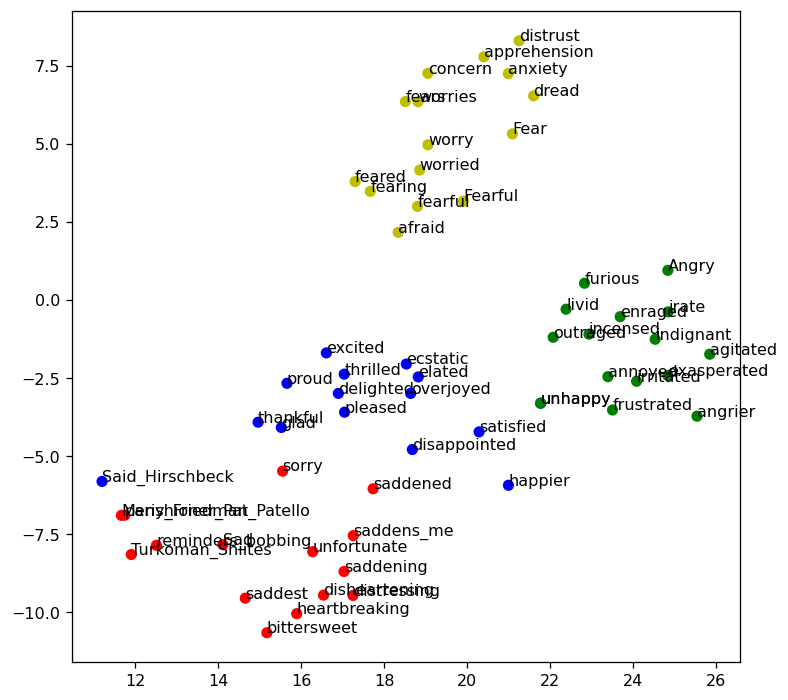

In [69]:
%matplotlib inline
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE

## w2v model
model = w2v_google_model

## prepare training word vectors
size = 200
target_size = len(target_words)
all_word = list(model.index_to_key)
word_train = target_words + all_word[:size]
X_train = model[word_train]

## t-SNE model
tsne = TSNE(n_components=2, metric='cosine', random_state=28)

## training
X_tsne = tsne.fit_transform(X_train)

## plot the result
plt.figure(figsize=(7.5, 7.5), dpi=115)
plt.scatter(X_tsne[:target_size, 0], X_tsne[:target_size, 1], c=color)
for label, x, y in zip(target_words, X_tsne[:target_size, 0], X_tsne[:target_size, 1]):
    plt.annotate(label, xy=(x,y), xytext=(0,0),  textcoords='offset points')
plt.show()

# 3. Part (Kaggle)

In [3]:
import zipfile
import pandas as pd
import json
from tqdm import tqdm

### 1. load data

In [4]:
# /kaggle/input/dm2021-lab2-hw2/tweets_DM.json
# /kaggle/input/dm2021-lab2-hw2/sampleSubmission.csv
# /kaggle/input/dm2021-lab2-hw2/data_identification.csv
# /kaggle/input/dm2021-lab2-hw2/emotion.csv

In [5]:
X_id = pd.read_csv('/kaggle/input/dm2021-lab2-hw2/data_identification.csv')
X_id.head()
X_id["identification"].value_counts()

train    1455563
test      411972
Name: identification, dtype: int64

In [6]:
json_lines = []

with open('/kaggle/input/dm2021-lab2-hw2/tweets_DM.json', 'r') as f:
    for line in tqdm(f):
        tweet = json.loads(line)['_source']
        json_lines.append([tweet["tweet"]["tweet_id"], tweet["tweet"]["text"]])
        

X_text = pd.DataFrame(json_lines, columns =['tweet_id', 'text'])
X_text.head()

1867535it [00:15, 116801.25it/s]


,tweet_id,text
0,0x376b20,"People who post ""add me on #Snapchat"" must be ..."
1,0x2d5350,"@brianklaas As we see, Trump is dangerous to #..."
2,0x28b412,"Confident of your obedience, I write to you, k..."
3,0x1cd5b0,Now ISSA is stalking Tasha 😂😂😂 <LH>
4,0x2de201,"""Trust is not the same as faith. A friend is s..."


In [7]:
X_id_text = pd.merge(X_id, X_text, on = "tweet_id")
X_id_text.head()

,tweet_id,identification,text
0,0x28cc61,test,@Habbo I've seen two separate colours of the e...
1,0x29e452,train,Huge Respect🖒 @JohnnyVegasReal talking about l...
2,0x2b3819,train,Yoooo we hit all our monthly goals with the ne...
3,0x2db41f,test,@FoxNews @KellyannePolls No serious self respe...
4,0x2a2acc,train,@KIDSNTS @PICU_BCH @uhbcomms @BWCHBoss Well do...


In [8]:
X_id_text_train =  X_id_text[X_id_text['identification'] == "train"]
X_test_df =  X_id_text[X_id_text['identification'] == "test"]
X_test_df.head()

,tweet_id,identification,text
0,0x28cc61,test,@Habbo I've seen two separate colours of the e...
3,0x2db41f,test,@FoxNews @KellyannePolls No serious self respe...
15,0x2466f6,test,"Looking for a new car, and it says 1 lady owne..."
23,0x23f9e9,test,@cineworld “only the brave” just out and fount...
31,0x1fb4e1,test,Felt like total dog 💩 going into open gym and ...


In [9]:
# reset index
X_test_df.reset_index(drop=True, inplace=True)
X_test_df.head()

,tweet_id,identification,text
0,0x28cc61,test,@Habbo I've seen two separate colours of the e...
1,0x2db41f,test,@FoxNews @KellyannePolls No serious self respe...
2,0x2466f6,test,"Looking for a new car, and it says 1 lady owne..."
3,0x23f9e9,test,@cineworld “only the brave” just out and fount...
4,0x1fb4e1,test,Felt like total dog 💩 going into open gym and ...


In [10]:
X_emotion = pd.read_csv('/kaggle/input/dm2021-lab2-hw2/emotion.csv')
X_train_df = pd.merge(X_id_text_train, X_emotion, on = "tweet_id")
X_train_df.head()

,tweet_id,identification,text,emotion
0,0x29e452,train,Huge Respect🖒 @JohnnyVegasReal talking about l...,joy
1,0x2b3819,train,Yoooo we hit all our monthly goals with the ne...,joy
2,0x2a2acc,train,@KIDSNTS @PICU_BCH @uhbcomms @BWCHBoss Well do...,trust
3,0x2a8830,train,Come join @ambushman27 on #PUBG while he striv...,joy
4,0x20b21d,train,@fanshixieen2014 Blessings!My #strength little...,anticipation


In [11]:
path = "/kaggle/working/"

X_train_df.to_pickle(path+"train.pkl")
X_test_df.to_pickle(path+"test.pkl")

## 2. data visualization

In [12]:
import plotly.express as px
import matplotlib.pyplot as plt

In [13]:
fig=px.histogram(X_train_df,
                x='emotion',
                title='Sentiment Count ',
                color_discrete_sequence=['green'])
fig.update_layout(bargap=0.1)
fig.show()
fig = px.pie(X_train_df, names='emotion',title="Sentiment Distribution")
fig.show()

#### Since the notebook is not showing the visualization (without running code), I added screenshots here:
![](visual1.png)
![](visual2.png)

## 3. pre-processing

In [14]:
import re
import numpy as np

In [15]:
import nltk

nltk.download('punkt')
nltk.download('stopwords')
nltk.download('wordnet')
from nltk.corpus import stopwords
from nltk.corpus import wordnet
from nltk.stem import WordNetLemmatizer
lemmatizer = WordNetLemmatizer() 
from gensim.models import Word2Vec

[nltk_data] Error loading punkt: <urlopen error [Errno -3] Temporary
[nltk_data]     failure in name resolution>
[nltk_data] Error loading stopwords: <urlopen error [Errno -3]
[nltk_data]     Temporary failure in name resolution>
[nltk_data] Error loading wordnet: <urlopen error [Errno -3] Temporary
[nltk_data]     failure in name resolution>


In [16]:
import string

def data_cleaning(data):
    cleaned_data = []
    fillerWord = ("so","yeah","okay","um","uh","mmm","ahan","uh","huh","ahm","oh","sooo","uh","huh","yeh","yah","hmm","bye")
    fillerword_reg= "bye[.,]|so[.,]|yeah[.,]|okay[.,]|um[.,]|uh[.,]|mmm[.,]|ahan[.,]|uh[.,]|huh[.,]|ahm[.,]|oh[.,]|sooo[.,]|uh[.,]|huh[.,]|yeh[.,]|yah[.,]|hmm[.,]"
    STOPWORDS = set(stopwords.words('english'))
    remove=["doesn't","not","nor","neither","isn't","hadn't","mightn't","needn't","wasn't"]
    for i in remove:
        STOPWORDS.discard(i)
    
    STOPWORDS.add(fillerWord)  
    for i in range(len(data)):
        tweet = re.sub("#", "", data[i])#extracting hashtags
        tweet = re.sub(r'^https?:\/\/.*[\r\n]*', '',tweet, flags=re.MULTILINE)#extracting links
        html=re.compile(r'<.*?>')#extracting html tags
        #tweet =html.sub(r"", tweet)
        #extracting symbols and characters
        tweet=re.sub(r'@\w+',"",tweet)
        tweet=re.sub(r'#\w+',"",tweet) 
        tweet = re.sub(r'"', " ", tweet)
        tweet = tweet.replace("<LH>", "")
        tweet = tweet.replace(r'?', " ")
        tweet = tweet.replace(r'!', " ")
        tweet = tweet.replace(r'.', " ")
        #tweet=re.sub(r'\w+:\/{2}[\d\w-]+(\.[\d\w-]+)*(?:(?:\/[^\s/]*))*', '', tweet) 
        #punctuation = r"\"!#$%&'()*+,-./:;<=>?@[\]^_`{|}~"
        #tweet.rstrip(string.punctuation)
#         tweet = re.sub(r"""
#                [,.;@#?!&$]+  # Accept one or more copies of punctuation
#                \ *           # plus zero or more copies of a space,
#                """,
#                " ",          # and replace it with a single space
#                tweet)
#         #tweet = re.sub(punctuation, " ", tweet)
#         tweet=re.sub('[^A-Za-z\s]+',"", tweet)
        tweet = tweet.lower()
        tweet = tweet.split()
        #Lemmatization to normalise text
        tweet = [lemmatizer.lemmatize(word) for word in tweet if not word in STOPWORDS]
        tweet = ' '.join(tweet)
        filler=re.compile(fillerword_reg)
        tweet=filler.sub("",tweet)
        cleaned_data.append(tweet)
    return cleaned_data

In [17]:
ex = [X_train_df['text'][343]]
print(ex)
print(data_cleaning(ex))

['The past 7 months of my life have been unexplainably amazing and fortunate #MoreLife 💜 #Living <LH>']
['past 7 month life unexplainably amazing fortunate morelife 💜 living']


In [18]:
####Preprocessing and cleaning train data
#X_train_df['OriginalLength']= X_train_df['text'].apply(lambda x: len(x.split(" ")))
texto_data=X_train_df['text'].tolist()
process_text=data_cleaning(texto_data)

cleaned_tweet =pd.DataFrame(process_text)
X_train_df['CleanedTweet']=cleaned_tweet

#Adding length of cleaned tweet to dataset
#X_train_df['NewLength']= X_train_df['CleanedTweet'].apply(lambda x:len(x.split(" ")))

X_train_df.head()

,tweet_id,identification,text,emotion,CleanedTweet
0,0x29e452,train,Huge Respect🖒 @JohnnyVegasReal talking about l...,joy,huge respect🖒 talking losing dad cancer dont r...
1,0x2b3819,train,Yoooo we hit all our monthly goals with the ne...,joy,yoooo hit monthly goal new app two week spater...
2,0x2a2acc,train,@KIDSNTS @PICU_BCH @uhbcomms @BWCHBoss Well do...,trust,well done team 🌟 every one
3,0x2a8830,train,Come join @ambushman27 on #PUBG while he striv...,joy,come join pubg strives chicken donners gamersu...
4,0x20b21d,train,@fanshixieen2014 Blessings!My #strength little...,anticipation,blessing strength little bone brittle door ope...


In [19]:
####Preprocessing and cleaning test data
#X_test_df['OriginalLength']= X_test_df['text'].apply(lambda x: len(str(x).split(" ")))
texto_data=X_test_df['text'].tolist()
process_text=data_cleaning(texto_data)

cleaned_tweet =pd.DataFrame(process_text)
X_test_df['CleanedTweet'] = cleaned_tweet

#X_test_df['NewLength']= X_test_df['CleanedTweet'].apply(lambda x:len(str(x).split(" ")))

X_test_df.head()

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,tweet_id,identification,text,CleanedTweet
0,0x28cc61,test,@Habbo I've seen two separate colours of the e...,i've seen two separate colour elegant furni ho...
1,0x2db41f,test,@FoxNews @KellyannePolls No serious self respe...,serious self respecting individual belief much...
2,0x2466f6,test,"Looking for a new car, and it says 1 lady owne...","looking new car, say 1 lady owner mean need ne..."
3,0x23f9e9,test,@cineworld “only the brave” just out and fount...,“only brave” fountain park 3 showing per day r...
4,0x1fb4e1,test,Felt like total dog 💩 going into open gym and ...,felt like total dog 💩 going open gym migraine ...


In [20]:
path = "/kaggle/working/"

X_train_df.to_pickle(path+"train.pkl")
X_test_df.to_pickle(path+"test.pkl")

In [21]:
path = "/kaggle/working/"

X_train_df = pd.read_pickle(path+"train.pkl")
X_test_df = pd.read_pickle(path+"test.pkl")

In [22]:
# X_train_df.head()

## 4. Feature Extraction (using TF-IDF)

In [23]:
X_train = X_train_df.CleanedTweet
y_train = X_train_df.emotion

In [24]:
# encode labels
from sklearn.preprocessing import LabelEncoder

encoder = LabelEncoder()
y_train = encoder.fit_transform(y_train)
y_train[:5]

array([4, 4, 7, 4, 1])

In [25]:
#from sklearn.feature_extraction.text import TfidfTransformer
from sklearn.feature_extraction.text import TfidfVectorizer

In [26]:
vectorizer = TfidfVectorizer()

X_train_data = vectorizer.fit_transform(X_train)
X_train_data.shape

(1455563, 470360)

## 5. Model training

In [27]:
from sklearn.model_selection import train_test_split
X1_train, X1_test, y1_train, y1_test = train_test_split(X_train_data, y_train, test_size=0.33,random_state = 15)

In [28]:
from sklearn.naive_bayes import MultinomialNB
from sklearn.metrics import accuracy_score

In [29]:
model1_nb = MultinomialNB(alpha=0.1)
y_train_pred = model1_nb.fit(X1_train,y1_train).predict(X1_train)

y_pred = model1_nb.predict(X1_test)
  
# comparing actual response values  with predicted response values 
from sklearn import metrics
print("Multinomial Naive Bayes model train accuracy(in %):", metrics.accuracy_score(y1_train, y_train_pred)*100)
print("Multinomial Naive Bayes model test accuracy(in %):", metrics.accuracy_score(y1_test, y_pred)*100)


Multinomial Naive Bayes model train accuracy(in %): 64.47791129654942
Multinomial Naive Bayes model test accuracy(in %): 51.01741281103228


In [30]:
#Hyper parameter tuning
from sklearn.model_selection import GridSearchCV

In [31]:
params = {'alpha': [0.01,0.1,0.5,1,10],
         }

multinomial_nb_grid = GridSearchCV(MultinomialNB(), param_grid=params, n_jobs=-1, cv=5, verbose=5)
multinomial_nb_grid.fit(X_train_data,y_train)

print('Train Accuracy : %.3f'%multinomial_nb_grid.best_estimator_.score(X1_train, y1_train))
print('Test Accuracy : %.3f'%multinomial_nb_grid.best_estimator_.score(X1_test, y1_test))
print('Best Accuracy Through Grid Search : %.3f'%multinomial_nb_grid.best_score_)
print('Best Parameters : ',multinomial_nb_grid.best_params_)


Fitting 5 folds for each of 5 candidates, totalling 25 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:    6.0s
[Parallel(n_jobs=-1)]: Done  25 out of  25 | elapsed:   12.5s finished


Train Accuracy : 0.639
Test Accuracy : 0.640
Best Accuracy Through Grid Search : 0.513
Best Parameters :  {'alpha': 0.1}


## 6. Predict on test data

In [32]:
test_ids = X_test_df["tweet_id"].to_list()

In [33]:
X_test = X_test_df.CleanedTweet.tolist()
X_test_data = vectorizer.transform(X_test)
X_test_data.shape

(411972, 470360)

In [34]:
y_test_pred = model1_nb.predict(X_test_data)

In [35]:
y_test_pred = encoder.inverse_transform(y_test_pred)
y_test_pred[:20]

array(['joy', 'joy', 'joy', 'joy', 'joy', 'joy', 'trust', 'joy', 'joy',
       'joy', 'joy', 'joy', 'sadness', 'joy', 'joy', 'joy', 'joy', 'joy',
       'joy', 'joy'], dtype=object)

In [36]:
result = []
for i, id in enumerate(test_ids):
    result.append([id, y_test_pred[i]])

In [37]:
result[0]

['0x28cc61', 'joy']

In [38]:
import csv

header = ['id', 'emotion']

path = "/kaggle/working/"
with open(path+'pred.csv', 'w', encoding='UTF8', newline='') as f:
    writer = csv.writer(f)

    # write the header
    writer.writerow(header)

    # write multiple rows
    writer.writerows(result)

In [2]:
# import os
# os.chdir(r'../working')
# from IPython.display import FileLink
# FileLink(r'pred.csv')